In [1]:
#from IPython.core.display import display, HTML
#display(HTML("<style>.container { width:90% !important; }</style>"))
#%matplotlib inline
import scvelo as scv
scv.logging.print_version()
import scanpy as scanpy
import anndata as anndata
import pandas as pd
import numpy as np
import cellrank as cr
import scipy.io as scipy
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy import sparse
scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo')
cr.settings.verbosity = 4
import os
os.getcwd()
cr.logging.print_versions()

Running scvelo 0.2.4 (python 3.7.8) on 2022-02-24 10:49.
cellrank==1.1.0 scanpy==1.6.0 anndata==0.7.1 numpy==1.19.2 numba==0.51.2 scipy==1.5.2 pandas==1.1.3 scikit-learn==0.23.2 statsmodels==0.12.1 scvelo==0.2.4 pygam==0.8.0 matplotlib==3.4.3 seaborn==0.11.0


In [ ]:
#adata = scv.read("/data/proj/GCB_DvB/humanPublication/Kriegsteindata/alltogether_cortex_final.loom", cache=True)

In [ ]:
#genenames = adata.var
#genenames.to_csv('/data/proj/GCB_DvB/humanPublication/Kriegsteindata/geneanno.csv')
#metadata = adata.obs
#metadata.to_csv('/data/proj/GCB_DvB/humanPublication/Kriegsteindata/metadata.csv')
#spliced = adata.layers['spliced']
#spliced = spliced.astype(np.int16)
#scipy.mmwrite('/data/proj/GCB_DvB/humanPublication/Kriegsteindata/spliced.mtx', spliced)
#unspliced = adata.layers['unspliced']
#unspliced = unspliced.astype(np.int16)
#scipy.mmwrite('/data/proj/GCB_DvB/humanPublication/Kriegsteindata/unspliced.mtx', unspliced)

In [ ]:
#adata.layers['spliced']

In [ ]:
#spliced

In [2]:
s = scv.read("/data/proj/GCB_DvB/humanPublication/pubsplicedFtrunc.csv").T
u = scv.read("/data/proj/GCB_DvB/humanPublication/pubunsplicedFtrunc.csv").T
adata = s
adata.layers['spliced'] = s.X
adata.layers['unspliced'] = u.X

In [3]:
m = pd.read_csv("/data/proj/GCB_DvB/humanPublication/pubanno.csv")
m[["seurat_clusters2"]] = m[["seurat_clusters2"]].astype(str) 
adata.obs['clusters'] = m['seurat_clusters2']
adata.obs['Sample'] = m['Sample']
adata.obs['version'] = m['version']
umap_anno = pd.read_csv("/data/proj/GCB_DvB/humanPublication/umapscVelo.csv")
adata.obsm['X_umap'] = np.asanyarray(umap_anno)

In [4]:
Xcorrect = scv.read("/data/proj/GCB_DvB/humanPublication/pubsplicedcorrected.csv").T
adata.X = Xcorrect.X

In [5]:
# show proportions of spliced/unspliced abundances
scv.utils.show_proportions(adata)
adata.shape

Abundance of ['spliced', 'unspliced']: [0.59 0.41]


(1940, 10000)

In [6]:
#scv.pp.filter_genes(adata, min_shared_counts=2)
#scv.pp.remove_duplicate_cells
#scv.pp.normalize_per_cell(adata, enforce=True)
#scv.pp.filter_genes_dispersion(adata, n_top_genes=10000)
#scv.pp.log1p(adata)
#scv.pp.neighbors(adata)
scv.pp.moments(adata, n_pcs=50)#, n_neighbors=5)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:05) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


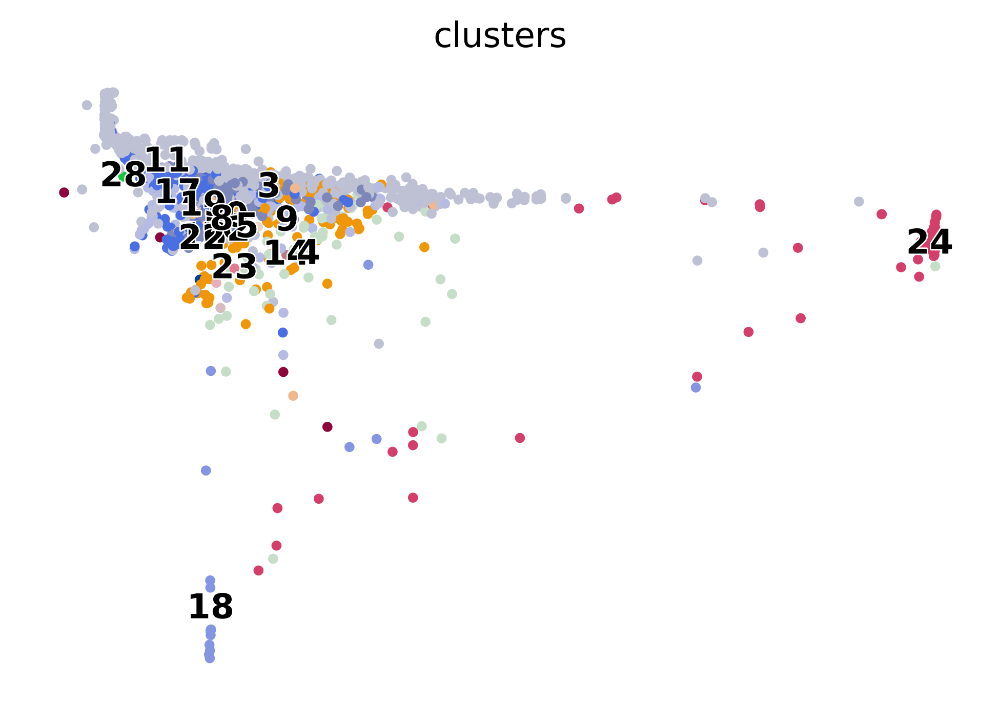

In [7]:
#Check if umap coordinates and clusters are correctly inferred
scv.pl.scatter(adata, basis='umap',size=50,linewidth=0.2,dpi=200)

In [8]:
#Recover dynamics and save
scv.tl.recover_dynamics(adata,n_jobs=20)
adata.write('/data/proj/GCB_DvB/humanPublication/SCvelolineage.h5ad', compression='gzip')

recovering dynamics (using 20/56 cores)



    finished (0:02:46) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [9]:
scv.tl.velocity(adata, mode='dynamical')
scv.tl.velocity_graph(adata)

computing velocities
    finished (0:00:05) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/56 cores)



    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


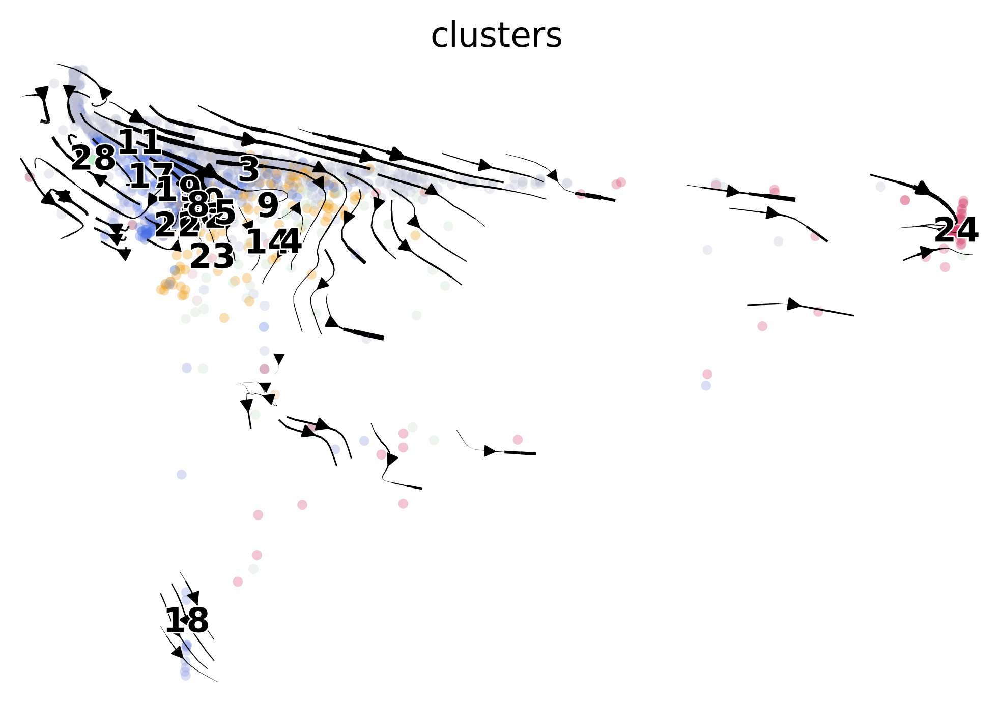

In [10]:
scv.pl.velocity_embedding_stream(adata, basis='umap',size=50,linewidth=1,dpi=200,density=2)

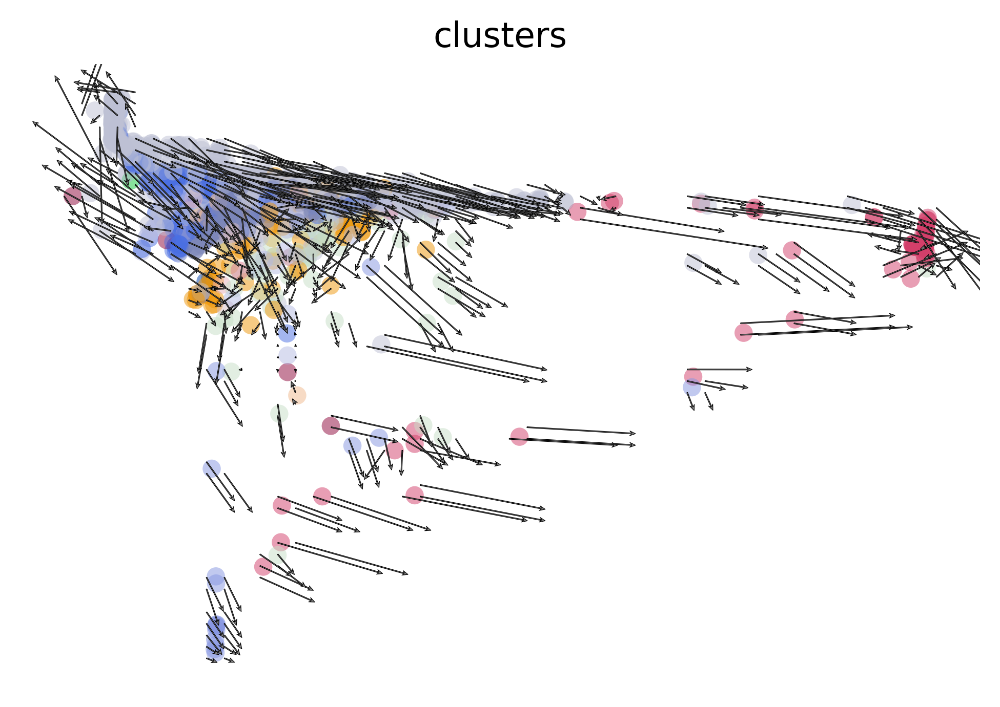

In [11]:
#scv.pl.velocity_embedding_grid(adata,basis='umap', arrow_length=4, arrow_size=1, dpi=200,density=2,linewidth=0.1)
scv.pl.velocity_embedding_grid(adata,basis='umap', arrow_length=4, arrow_size=1, dpi=200,density=1,linewidth=0.2,alpha=0.5)

computing terminal states
    identified 1 region of root cells and 1 region of end points .
    finished (0:00:00) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
computing latent time using root_cells as prior
    finished (0:00:02) --> added 
    'latent_time', shared time (adata.obs)


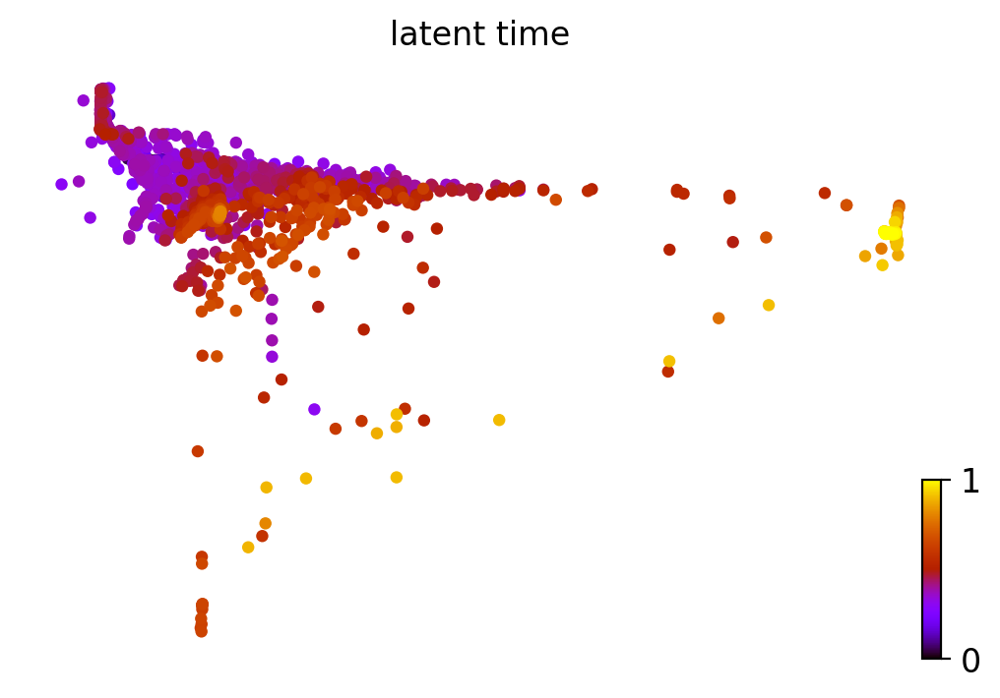

In [12]:
scv.tl.latent_time(adata)
scv.pl.scatter(adata, color='latent_time', color_map='gnuplot', size=80)

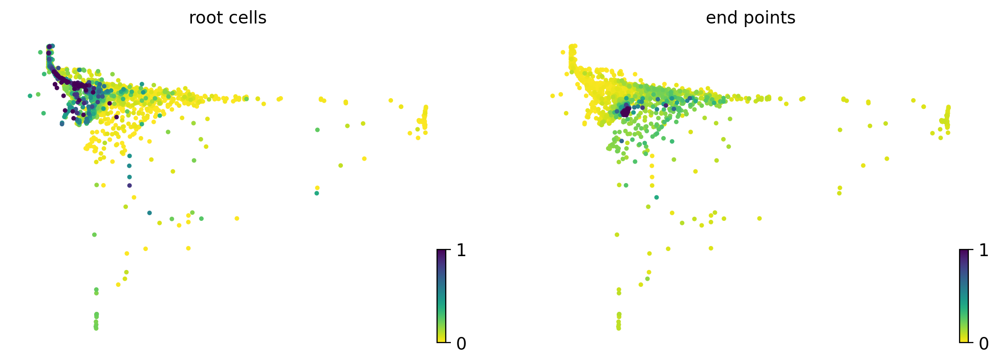

In [13]:
scv.pl.scatter(adata,color=["root_cells", "end_points" ])

In [ ]:
lt = adata.obs["latent_time"]
lt.to_csv('/data/proj/GCB_DvB/humanPublication/scVELOLT_FSCCA30NNvelo.csv')
transmat = scv.utils.get_transition_matrix(adata)
scipy.mmwrite('/data/proj/GCB_DvB/humanPublication/scVELOtransmatFSCCA30NNvelo.mtx', transmat)

In [ ]:
scv.pl.velocity_embedding_grid(adata, color=['TOP2A','PTCH1','EGFR','SPARCL1','GFAP','CSPG4','PDGFRA','ASCL1','GAD1','LHX1']
                               ,basis='umap', arrow_length=2, arrow_size=4, dpi=200,density=0.35,ncols=4,size=1500,
                              linewidth=1.5,fontsize = 40,alpha=0.8)

In [59]:
scv.pl.velocity_embedding_grid(adata, color=['CSPG4','PDGFRA','APOD','BAMBI','PTCH1','CNTN1','JAG1','NOTCH1','NOTCH4','DLL3','DLL1','ZEB1','EGFR',
                                             'MFNG','NHLH1','SHOX2','TFDP2','SOX4','SOX11','TP53','PROX1',
                                             'CDKN1C','TOP2A','DCX','NFIX','NEUROG1','NEUROG2','HES6']
                               ,basis='umap', arrow_length=2, arrow_size=4, dpi=200,density=0.35,ncols=4,size=1500,
                              linewidth=1.5,fontsize = 40,alpha=0.8)

In [ ]:
scv.pl.velocity_embedding_grid(adata, color=['CSPG4','PDGFRA','PTCH1','MFNG',
                                             'CNTN1','JAG1','NOTCH1','NOTCH4',
                                             'ASCL1','ETV1','SOX4','SOX11',
                                             'TFDP2','SHOX2','SPARCL1','GFAP']
                               ,basis='umap', arrow_length=2, arrow_size=4, dpi=200,density=0.35,ncols=4,size=1500,
                              linewidth=1.5,fontsize = 40,alpha=0.8)

In [ ]:
scv.pl.velocity_embedding_grid(adata, color=['DLL3','DLL1','ZEB1','EGFR']
                               ,basis='umap', arrow_length=2, arrow_size=4, dpi=200,density=0.35,ncols=4,size=1500,
                              linewidth=1.5,fontsize = 40,alpha=0.8)

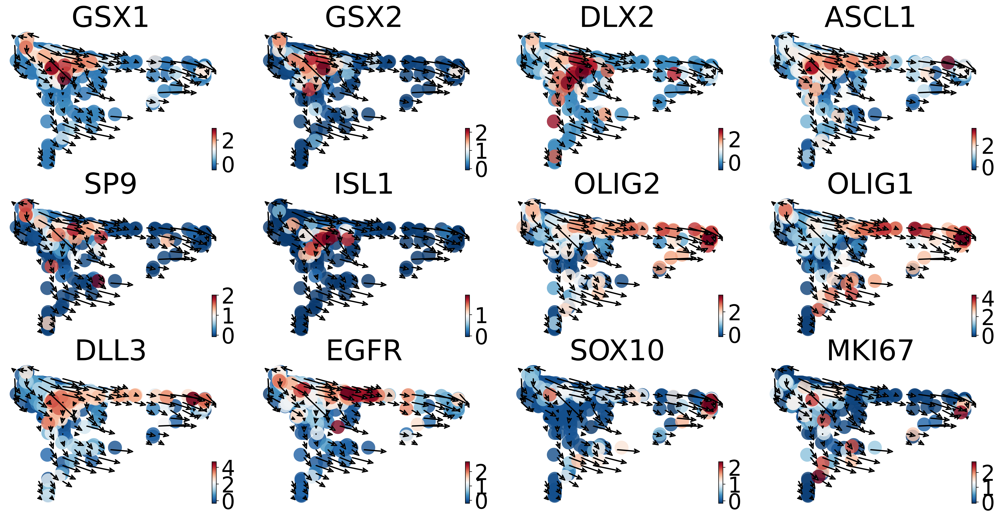

In [41]:
scv.pl.velocity_embedding_grid(adata, color=['GSX1','GSX2','DLX2','ASCL1','SP9','ISL1','OLIG2','OLIG1','DLL3','EGFR','SOX10','MKI67']
                               ,basis='umap', arrow_length=2, arrow_size=4, dpi=200,density=0.35,ncols=4,size=1500,
                              linewidth=1.5,fontsize = 40,alpha=0.8)

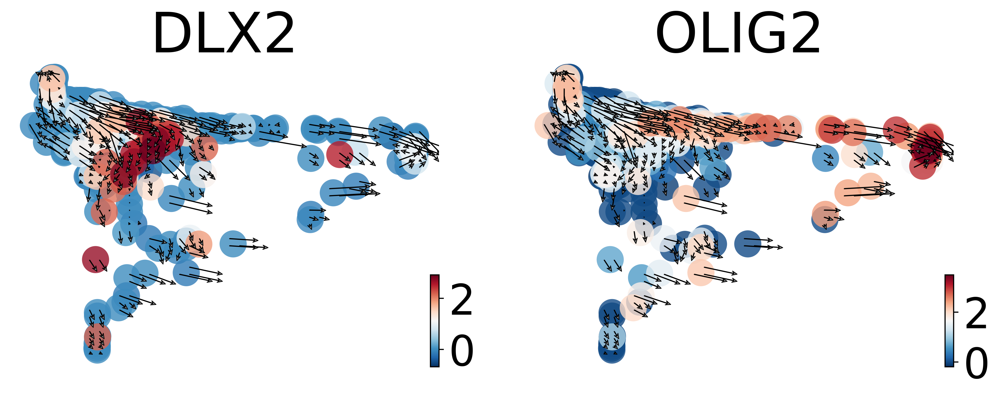

In [58]:
scv.pl.velocity_embedding_grid(adata, color=['DLX2','OLIG2']
                               ,basis='umap', arrow_length=2, arrow_size=2, dpi=200,density=0.8,ncols=4,size=1500,
                              linewidth=0.5,fontsize = 40,alpha=0.8)